In [11]:
import numpy as np
import time
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from scipy.spatial import cKDTree

## Skeleton

In [2]:
def init_boids(N, width, height, speed_range=(1.0, 3.0), seed=0):
    """
    Initialize boids with random positions and velocities.

    Returns
    -------
    positions : (N,2) ndarray
    velocities: (N,2) ndarray
    """
    rng = np.random.default_rng(seed)

    positions = np.column_stack([
        rng.uniform(0, width, size=N),
        rng.uniform(0, height, size=N)
    ]).astype(float)

    angles = rng.uniform(0, 2*np.pi, size=N)
    directions = np.column_stack([np.cos(angles), np.sin(angles)])

    speeds = rng.uniform(speed_range[0], speed_range[1], size=N)
    velocities = (directions * speeds[:, None]).astype(float)

    return positions, velocities


def apply_boundary(positions, velocities, width, height, mode="wrap"):
    """
    Apply boundary handling in-place for all boids.

    mode = "wrap"    : toroidal wrap-around (velocity unchanged)
    mode = "reflect" : bounce off walls (flip velocity component)
    """
    if mode == "wrap":
        positions[:, 0] %= width
        positions[:, 1] %= height
        return

    if mode == "reflect":
        # x walls
        left = positions[:, 0] < 0
        positions[left, 0] = 0.0
        velocities[left, 0] *= -1.0

        right = positions[:, 0] > width
        positions[right, 0] = width
        velocities[right, 0] *= -1.0

        # y walls
        bottom = positions[:, 1] < 0
        positions[bottom, 1] = 0.0
        velocities[bottom, 1] *= -1.0

        top = positions[:, 1] > height
        positions[top, 1] = height
        velocities[top, 1] *= -1.0
        return

    raise ValueError("mode must be 'wrap' or 'reflect'")

def step(positions, velocities, dt, width, height, boundary_mode="wrap"):
    """
    Minimal simulation update (no flocking rules yet).
    Positions are updated using constant velocities.
    """
    positions = positions + velocities * dt
    apply_boundary(positions, velocities, width, height, mode=boundary_mode)
    return positions, velocities


In [3]:

# -------------------------
# Tiny smoke test (10 steps)
# -------------------------
if __name__ == "__main__":
    N = 30
    width, height = 800.0, 600.0
    dt = 0.1

    # Wrap test
    positions, velocities = init_boids(N, width, height, speed_range=(20.0, 60.0), seed=42)
    for _ in range(10):
        positions, velocities = step(positions, velocities, dt, width, height, boundary_mode="wrap")
        assert positions.shape == (N, 2)
        assert velocities.shape == (N, 2)
        assert np.all(np.isfinite(positions))
        assert np.all(np.isfinite(velocities))

    # Reflect test
    positions2, velocities2 = init_boids(N, width, height, speed_range=(20.0, 60.0), seed=1)
    for _ in range(10):
        positions2, velocities2 = step(positions2, velocities2, dt, width, height, boundary_mode="reflect")
        assert np.all(positions2[:, 0] >= 0) and np.all(positions2[:, 0] <= width)
        assert np.all(positions2[:, 1] >= 0) and np.all(positions2[:, 1] <= height)

    print("Smoke test passed (wrap and reflect).")


Smoke test passed (wrap and reflect).


## Combination of all rules

In [4]:
import numpy as np

# -------------------------
# Vector helpers
# -------------------------
def normalize_or_zero(v: np.ndarray) -> np.ndarray:
    """Return v / ||v||, or zeros if ||v|| == 0."""
    n = np.linalg.norm(v)
    if n == 0:
        return np.zeros_like(v, dtype=float)
    return v / n

def limit_magnitude(v: np.ndarray, max_mag: float) -> np.ndarray:
    """Scale v down so that ||v|| <= max_mag."""
    n = np.linalg.norm(v)
    if n > max_mag and n > 0:
        return v * (max_mag / n)
    return v

# -------------------------
# Initialization
# -------------------------
def init_boids(N: int, width: float, height: float, speed_range=(1.0, 3.0), seed=0):
    rng = np.random.default_rng(seed)

    positions = np.column_stack([
        rng.uniform(0, width, size=N),
        rng.uniform(0, height, size=N)
    ]).astype(float)

    angles = rng.uniform(0, 2*np.pi, size=N)
    directions = np.column_stack([np.cos(angles), np.sin(angles)])

    speeds = rng.uniform(speed_range[0], speed_range[1], size=N)
    velocities = (directions * speeds[:, None]).astype(float)

    return positions, velocities

# -------------------------
# Neighbor search (simple O(N^2))
# -------------------------
def get_neighbors(i: int, positions: np.ndarray, radius: float) -> np.ndarray:
    """Return indices of boids within 'radius' of boid i (excluding i)."""
    diffs = positions - positions[i]                      # (N,2)
    d2 = np.sum(diffs * diffs, axis=1)                    # (N,)
    mask = (d2 > 0) & (d2 <= radius * radius)
    return np.where(mask)[0]

# -------------------------
# Steering rules
# -------------------------
def steer_separation(i, positions, velocities, neighbors, sep_radius, max_speed, max_force):
    """Push away from neighbors that are too close (within sep_radius)."""
    if neighbors.size == 0:
        return np.zeros(2)

    away = np.zeros(2)
    count = 0
    for j in neighbors:
        diff = positions[i] - positions[j]
        d2 = float(diff[0]*diff[0] + diff[1]*diff[1])
        if d2 == 0:
            continue
        if d2 <= sep_radius * sep_radius:
            # stronger repulsion when closer (1/d^2)
            away += diff / d2
            count += 1

    if count == 0:
        return np.zeros(2)

    away /= count
    desired = normalize_or_zero(away) * max_speed
    steer = desired - velocities[i]
    return limit_magnitude(steer, max_force)

def steer_alignment(i, velocities, neighbors, max_speed, max_force):
    """Match heading: steer toward the average neighbor velocity."""
    if neighbors.size == 0:
        return np.zeros(2)

    avg_vel = np.mean(velocities[neighbors], axis=0)
    desired = normalize_or_zero(avg_vel) * max_speed
    steer = desired - velocities[i]
    return limit_magnitude(steer, max_force)

def steer_cohesion(i, positions, velocities, neighbors, max_speed, max_force):
    """Stay together: steer toward the average neighbor position (center)."""
    if neighbors.size == 0:
        return np.zeros(2)

    center = np.mean(positions[neighbors], axis=0)
    to_center = center - positions[i]
    desired = normalize_or_zero(to_center) * max_speed
    steer = desired - velocities[i]
    return limit_magnitude(steer, max_force)

# -------------------------
# Boundaries
# -------------------------
def apply_boundary(positions, velocities, width, height, mode="wrap"):
    """Apply boundary handling in-place for all boids."""
    if mode == "wrap":
        positions[:, 0] %= width
        positions[:, 1] %= height
        return

    if mode == "reflect":
        left = positions[:, 0] < 0
        positions[left, 0] = 0.0
        velocities[left, 0] *= -1.0

        right = positions[:, 0] > width
        positions[right, 0] = width
        velocities[right, 0] *= -1.0

        bottom = positions[:, 1] < 0
        positions[bottom, 1] = 0.0
        velocities[bottom, 1] *= -1.0

        top = positions[:, 1] > height
        positions[top, 1] = height
        velocities[top, 1] *= -1.0
        return

    raise ValueError("mode must be 'wrap' or 'reflect'")

# -------------------------
# One simulation step (two-phase update)
# -------------------------
def step(positions, velocities, params):
    """
    1) Compute all accelerations from the current state (no update-order bias)
    2) Update velocities and clamp speed
    3) Update positions
    4) Apply boundaries
    """
    N = positions.shape[0]
    acc = np.zeros_like(positions)

    # Phase 1: compute accelerations
    for i in range(N):
        neighbors = get_neighbors(i, positions, params["perception_radius"])

        sep = steer_separation(
            i, positions, velocities, neighbors,
            params["sep_radius"], params["max_speed"], params["max_force"]
        )
        ali = steer_alignment(
            i, velocities, neighbors,
            params["max_speed"], params["max_force"]
        )
        coh = steer_cohesion(
            i, positions, velocities, neighbors,
            params["max_speed"], params["max_force"]
        )

        a = params["w_sep"]*sep + params["w_align"]*ali + params["w_coh"]*coh
        acc[i] = limit_magnitude(a, params["max_force"])

    # Phase 2: integrate motion
    velocities = velocities + acc * params["dt"]

    # Clamp speed of each boid
    speeds = np.linalg.norm(velocities, axis=1)
    too_fast = speeds > params["max_speed"]
    if np.any(too_fast):
        velocities[too_fast] *= (params["max_speed"] / speeds[too_fast])[:, None]

    positions = positions + velocities * params["dt"]

    # Boundaries
    apply_boundary(positions, velocities, params["width"], params["height"], params["boundary_mode"])
    return positions, velocities

# -------------------------
# Tiny smoke test (10 steps)
# -------------------------
if __name__ == "__main__":
    params = {
        "N": 60,
        "width": 800.0,
        "height": 600.0,
        "dt": 0.1,
        "perception_radius": 60.0,  # who counts as a neighbor
        "sep_radius": 20.0,         # "too close" distance
        "w_sep": 1.5,
        "w_align": 1.0,
        "w_coh": 1.0,
        "max_speed": 80.0,
        "max_force": 40.0,
        "boundary_mode": "wrap",    # or "reflect"
    }

    positions, velocities = init_boids(params["N"], params["width"], params["height"],
                                       speed_range=(30.0, 70.0), seed=42)

    for _ in range(10):
        positions, velocities = step(positions, velocities, params)
        assert np.all(np.isfinite(positions))
        assert np.all(np.isfinite(velocities))
        assert np.max(np.linalg.norm(velocities, axis=1)) <= params["max_speed"] + 1e-9

    print("Smoke test passed (with flocking rules).")


Smoke test passed (with flocking rules).


## Visualization

In [23]:


# -------------------------
# Boids core (same as before)
# -------------------------
def normalize_or_zero(v: np.ndarray) -> np.ndarray:
    n = np.linalg.norm(v)
    return np.zeros_like(v, dtype=float) if n == 0 else (v / n)

def limit_magnitude(v: np.ndarray, max_mag: float) -> np.ndarray:
    n = np.linalg.norm(v)
    if n > max_mag and n > 0:
        return v * (max_mag / n)
    return v

def init_boids(N: int, width: float, height: float, speed_range=(1.0, 3.0), seed=0):
    rng = np.random.default_rng(seed)

    positions = np.column_stack([
        rng.uniform(0, width, size=N),
        rng.uniform(0, height, size=N)
    ]).astype(float)

    angles = rng.uniform(0, 2*np.pi, size=N)
    directions = np.column_stack([np.cos(angles), np.sin(angles)])
    speeds = rng.uniform(speed_range[0], speed_range[1], size=N)
    velocities = (directions * speeds[:, None]).astype(float)

    return positions, velocities

def get_neighbors(i: int, positions: np.ndarray, radius: float) -> np.ndarray:
    diffs = positions - positions[i]
    d2 = np.sum(diffs * diffs, axis=1)
    mask = (d2 > 0) & (d2 <= radius * radius)
    return np.where(mask)[0]

def steer_separation(i, positions, velocities, neighbors, sep_radius, max_speed, max_force):
    if neighbors.size == 0:
        return np.zeros(2)

    away = np.zeros(2)
    count = 0
    sep2 = sep_radius * sep_radius

    for j in neighbors:
        diff = positions[i] - positions[j]
        d2 = float(diff[0]*diff[0] + diff[1]*diff[1])
        if d2 == 0:
            continue
        if d2 <= sep2:
            away += diff / d2  # stronger when closer
            count += 1

    if count == 0:
        return np.zeros(2)

    away /= count
    desired = normalize_or_zero(away) * max_speed
    steer = desired - velocities[i]
    return limit_magnitude(steer, max_force)

def steer_alignment(i, velocities, neighbors, max_speed, max_force):
    if neighbors.size == 0:
        return np.zeros(2)
    avg_vel = np.mean(velocities[neighbors], axis=0)
    desired = normalize_or_zero(avg_vel) * max_speed
    steer = desired - velocities[i]
    return limit_magnitude(steer, max_force)

def steer_cohesion(i, positions, velocities, neighbors, max_speed, max_force):
    if neighbors.size == 0:
        return np.zeros(2)
    center = np.mean(positions[neighbors], axis=0)
    to_center = center - positions[i]
    desired = normalize_or_zero(to_center) * max_speed
    steer = desired - velocities[i]
    return limit_magnitude(steer, max_force)

def apply_boundary(positions, velocities, width, height, mode="wrap"):
    if mode == "wrap":
        positions[:, 0] %= width
        positions[:, 1] %= height
        return

    if mode == "reflect":
        left = positions[:, 0] < 0
        positions[left, 0] = 0.0
        velocities[left, 0] *= -1.0

        right = positions[:, 0] > width
        positions[right, 0] = width
        velocities[right, 0] *= -1.0

        bottom = positions[:, 1] < 0
        positions[bottom, 1] = 0.0
        velocities[bottom, 1] *= -1.0

        top = positions[:, 1] > height
        positions[top, 1] = height
        velocities[top, 1] *= -1.0
        return

    raise ValueError("mode must be 'wrap' or 'reflect'")

def step(positions, velocities, params, predator=None, get_neighbors_fn=get_neighbors):
    N = positions.shape[0]
    acc = np.zeros_like(positions)

    # predator params (only used if predator is not None)
    pred_avoid_radius = params.get("pred_avoid_radius", 120.0)
    pred_danger_radius = params.get("pred_danger_radius", 80.0)
    w_pred = params.get("w_pred", 3.0)

    # Phase 1: compute accelerations from old state
    for i in range(N):
        neighbors = get_neighbors_fn(i, positions, params["perception_radius"])

        sep = steer_separation(
            i, positions, velocities, neighbors,
            params["sep_radius"], params["max_speed"], params["max_force"]
        )
        ali = steer_alignment(
            i, velocities, neighbors,
            params["max_speed"], params["max_force"]
        )
        coh = steer_cohesion(
            i, positions, velocities, neighbors,
            params["max_speed"], params["max_force"]
        )

        # default weights
        w_coh_eff = params["w_coh"]
        pred_steer = np.zeros(2)
        w_pred_eff = 0.0

        # add predator avoidance if predator is present
        if predator is not None:
            pred_pos = predator.position
            diff = positions[i] - pred_pos
            dist = np.linalg.norm(diff)

            if 0 < dist <= pred_avoid_radius:
                # steer away like separation
                away_dir = diff / dist
                desired = away_dir * params["max_speed"]
                pred_steer = desired - velocities[i]
                pred_steer = limit_magnitude(pred_steer, params["max_force"])
                w_pred_eff = w_pred

                # priority: if very close, reduce cohesion and boost avoidance
                if dist < pred_danger_radius and pred_danger_radius > 0:
                    p = 1.0 - dist / pred_danger_radius  # in (0,1)
                    w_coh_eff = params["w_coh"] * (1.0 - p)
                    w_pred_eff = w_pred * (1.0 + 2.0 * p)

        a = (
            params["w_sep"] * sep +
            params["w_align"] * ali +
            w_coh_eff * coh +
            w_pred_eff * pred_steer
        )
        acc[i] = limit_magnitude(a, params["max_force"])

    # Phase 2: integrate
    velocities = velocities + acc * params["dt"]

    # clamp speed
    speeds = np.linalg.norm(velocities, axis=1)
    too_fast = speeds > params["max_speed"]
    if np.any(too_fast):
        velocities[too_fast] *= (params["max_speed"] / speeds[too_fast])[:, None]

    positions = positions + velocities * params["dt"]

    apply_boundary(positions, velocities, params["width"], params["height"], params["boundary_mode"])
    return positions, velocities



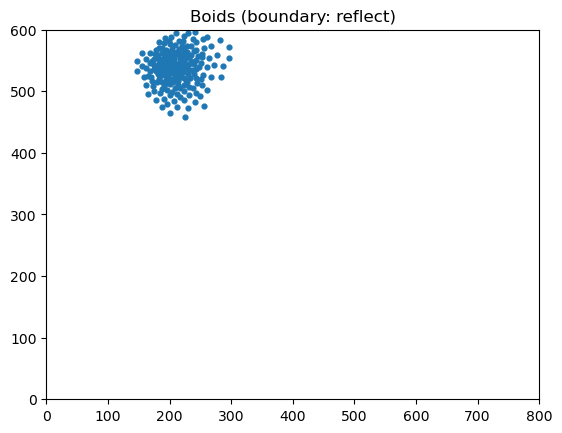

In [5]:
# --- parameters ---
params = {
    "N": 200,
    "width": 800.0,
    "height": 600.0,
    "dt": 0.08,
    "perception_radius": 150.0,
    "sep_radius": 15.0,
    "w_sep": 1.6,
    "w_align": 1.2,
    "w_coh": 1.2,
    "max_speed": 90.0,
    "max_force": 45.0,
    "boundary_mode": "reflect",  # or "wrap"
}

# --- init ---
positions, velocities = init_boids(
    params["N"], params["width"], params["height"],
    speed_range=(30.0, 70.0), seed=42
)

fig, ax = plt.subplots()
ax.set_xlim(0, params["width"])
ax.set_ylim(0, params["height"])
ax.set_aspect("equal", adjustable="box")
ax.set_title(f"Boids (boundary: {params['boundary_mode']})")

scat = ax.scatter(positions[:, 0], positions[:, 1], s=12)

def update(_):
    global positions, velocities
    positions, velocities = step(positions, velocities, params)
    scat.set_offsets(positions)
    return scat,

ani = FuncAnimation(fig, update, frames=400, interval=30, blit=False)

HTML(ani.to_jshtml())


## Correctness Check

In [ ]:
# No NaNs / no explosions
for _ in range(200):
    positions, velocities = step(positions, velocities, params)
    assert np.all(np.isfinite(positions))
    assert np.all(np.isfinite(velocities))

In [ ]:
# Speed clamp
speeds = np.linalg.norm(velocities, axis=1)
assert speeds.max() <= params["max_speed"] + 1e-9

In [ ]:
# Boundary correctness
# wrap
assert np.all((positions[:,0] >= 0) & (positions[:,0] < params["width"]))
assert np.all((positions[:,1] >= 0) & (positions[:,1] < params["height"]))


In [ ]:

# reflect
assert np.all((positions[:,0] >= 0) & (positions[:,0] <= params["width"]))
assert np.all((positions[:,1] >= 0) & (positions[:,1] <= params["height"]))

In [12]:
# “Empty neighbor” check (edge case)
i = 0
positions[i] = np.array([0.0, 0.0])
positions[1:] = np.array([params["width"], params["height"]])  # far away
neighbors = get_neighbors(i, positions, params["perception_radius"])
assert neighbors.size == 0
# acceleration should not blow up

In [13]:
# Symmetry check (catches sign bugs)
pos = np.array([[5.,5.],[4.,5.],[6.,5.]])
vel = np.zeros((3,2))
nbrs = np.array([1,2])
s = steer_separation(0, pos, vel, nbrs, sep_radius=5, max_speed=1, max_force=10)
assert np.linalg.norm(s) < 1e-6

## Tire 1 Spatial Optimization (KDTree)

In [9]:
def benchmark_full_step(step_fn, init_fn, params_base, Ns=(50, 200, 500),
                        steps=200, warmup=30, repeats=3, seed=42):
    """
    Benchmarks average runtime per step (full simulation update).
    Returns a list of dicts with mean/std in milliseconds.
    """
    results = []

    for N in Ns:
        per_step_times = []

        for r in range(repeats):
            params = dict(params_base)
            params["N"] = N

            positions, velocities = init_fn(
                N, params["width"], params["height"],
                speed_range=(30.0, 70.0), seed=seed + r
            )

            # Warm-up (not timed)
            for _ in range(warmup):
                positions, velocities = step_fn(positions, velocities, params)

            # Timed
            t0 = time.perf_counter()
            for _ in range(steps):
                positions, velocities = step_fn(positions, velocities, params)
            t1 = time.perf_counter()

            per_step_times.append((t1 - t0) / steps)

        mean_ms = float(np.mean(per_step_times) * 1000.0)
        std_ms  = float(np.std(per_step_times) * 1000.0)

        results.append({
            "N": N,
            "mean_ms_per_step": mean_ms,
            "std_ms_per_step": std_ms
        })
        print(f"[FULL STEP] N={N:4d}  mean={mean_ms:.3f} ms/step  std={std_ms:.3f}")

    return results


def benchmark_neighbor_only(get_neighbors_fn, init_fn, params_base, Ns=(50, 200, 500),
                            repeats=5, seed=123):
    """
    Benchmarks ONLY the neighbor-search cost:
    for each repeat, call get_neighbors(i, positions, radius) for i=0..N-1.
    Returns mean/std in milliseconds per full neighbor-pass (over all boids).
    """
    results = []
    radius = params_base["perception_radius"]

    for N in Ns:
        pass_times = []

        for r in range(repeats):
            positions, velocities = init_fn(
                N, params_base["width"], params_base["height"],
                speed_range=(30.0, 70.0), seed=seed + r
            )

            # Timed: one "neighbor pass" = neighbors for all boids
            t0 = time.perf_counter()
            for i in range(N):
                _ = get_neighbors_fn(i, positions, radius)
            t1 = time.perf_counter()

            pass_times.append(t1 - t0)

        mean_ms = float(np.mean(pass_times) * 1000.0)
        std_ms  = float(np.std(pass_times) * 1000.0)

        results.append({
            "N": N,
            "mean_ms_per_neighbor_pass": mean_ms,
            "std_ms_per_neighbor_pass": std_ms
        })
        print(f"[NEIGHBORS] N={N:4d}  mean={mean_ms:.3f} ms/pass  std={std_ms:.3f}")

    return results



In [10]:
params_base = {
    "width": 800.0,
    "height": 600.0,
    "dt": 0.08,
    "perception_radius": 70.0,
    "sep_radius": 22.0,
    "w_sep": 1.6,
    "w_align": 1.0,
    "w_coh": 1.0,
    "max_speed": 90.0,
    "max_force": 45.0,
    "boundary_mode": "wrap",   # keep fixed while benchmarking
}

# Full step timing:
full_results = benchmark_full_step(step, init_boids, params_base, Ns=(50,200,500))

# Neighbor-only timing:
neighbor_results = benchmark_neighbor_only(get_neighbors, init_boids, params_base, Ns=(50,200,500))


[FULL STEP] N=  50  mean=1.879 ms/step  std=0.020
[FULL STEP] N= 200  mean=10.681 ms/step  std=0.919
[FULL STEP] N= 500  mean=35.386 ms/step  std=0.689
[NEIGHBORS] N=  50  mean=0.250 ms/pass  std=0.009
[NEIGHBORS] N= 200  mean=1.284 ms/pass  std=0.006
[NEIGHBORS] N= 500  mean=4.925 ms/pass  std=0.087


In [ ]:
def get_neighbors_kdtree(i: int, tree: cKDTree, radius: float) -> np.ndarray:
    """
    Return indices of boids within 'radius' of boid i, excluding i itself.
    tree: cKDTree built from positions (shape (N,2)).
    """
    idxs = tree.query_ball_point(tree.data[i], r=radius)  # list of indices
    if i in idxs:
        idxs.remove(i)  # exclude self
    return np.array(idxs, dtype=int)

def step_kdtree(positions, velocities, params):
    """
    Same logic as step(), but neighbor search uses KDTree.
    KDTree is rebuilt once per frame (positions change each step).
    """
    N = positions.shape[0]
    acc = np.zeros_like(positions)

    # Build KDTree ONCE per frame
    tree = cKDTree(positions)

    # Phase 1: compute accelerations
    for i in range(N):
        neighbors = get_neighbors_kdtree(i, tree, params["perception_radius"])

        sep = steer_separation(
            i, positions, velocities, neighbors,
            params["sep_radius"], params["max_speed"], params["max_force"]
        )
        ali = steer_alignment(
            i, velocities, neighbors,
            params["max_speed"], params["max_force"]
        )
        coh = steer_cohesion(
            i, positions, velocities, neighbors,
            params["max_speed"], params["max_force"]
        )

        a = params["w_sep"]*sep + params["w_align"]*ali + params["w_coh"]*coh
        acc[i] = limit_magnitude(a, params["max_force"])

    # Phase 2: integrate motion
    velocities = velocities + acc * params["dt"]

    # Clamp speed
    speeds = np.linalg.norm(velocities, axis=1)
    too_fast = speeds > params["max_speed"]
    if np.any(too_fast):
        velocities[too_fast] *= (params["max_speed"] / speeds[too_fast])[:, None]

    positions = positions + velocities * params["dt"]

    # Boundaries
    apply_boundary(positions, velocities, params["width"], params["height"], params["boundary_mode"])
    return positions, velocities


def check_neighbors_match(positions, radius):
    tree = cKDTree(positions)
    N = positions.shape[0]
    for i in range(N):
        a = set(get_neighbors(i, positions, radius).tolist())               # naive
        b = set(get_neighbors_kdtree(i, tree, radius).tolist())             # KDTree
        assert a == b
    print("Neighbor sets match (naive vs KDTree).")


positions, velocities = init_boids(50, params["width"], params["height"], seed=0, speed_range=(30,70))
check_neighbors_match(positions, params["perception_radius"])


Neighbor sets match (naive vs KDTree).


In [14]:
def neighbors_naive(i, positions, radius):
    diffs = positions - positions[i]
    d2 = np.sum(diffs * diffs, axis=1)
    mask = (d2 > 0) & (d2 <= radius * radius)
    return np.where(mask)[0]

def neighbors_kdtree(i, tree, radius):
    idxs = tree.query_ball_point(tree.data[i], r=radius)
    if i in idxs:
        idxs.remove(i)
    return np.array(idxs, dtype=int)

def test_neighbor_sets_match_smallN():
    # fixed seed for reproducibility
    seed = 123
    N = 50
    width, height = 800.0, 600.0
    radius = 70.0

    rng = np.random.default_rng(seed)
    positions = np.column_stack([
        rng.uniform(0, width, size=N),
        rng.uniform(0, height, size=N)
    ]).astype(float)

    tree = cKDTree(positions)

    for i in range(N):
        a = set(neighbors_naive(i, positions, radius).tolist())
        b = set(neighbors_kdtree(i, tree, radius).tolist())
        assert a == b, f"Mismatch at boid {i}: naive={a}, kdtree={b}"

    print("PASS: Neighbor sets match exactly for small N.")

test_neighbor_sets_match_smallN()


PASS: Neighbor sets match exactly for small N.


Runtime benchmark (average time per step)
---------------------------------------------------------------
    N |   Naive (ms) |  KDTree (ms) |  Speedup
---------------------------------------------------------------
   50 |     1.917 ± 0.029 |     1.882 ± 0.035 |     1.02x
  200 |    10.763 ± 0.846 |    10.441 ± 0.970 |     1.03x
  500 |    35.877 ± 0.313 |    33.077 ± 0.788 |     1.08x
---------------------------------------------------------------


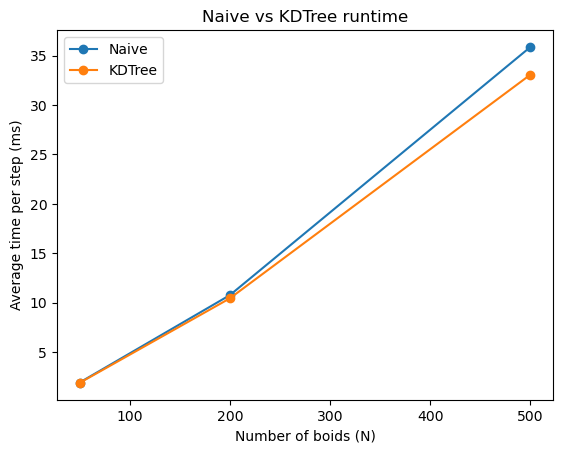

In [ ]:
def time_per_step(step_fn, init_fn, params_base, N, steps=200, warmup=30, repeats=3, seed=42):
    """Return mean/std time per step (seconds) for a given step function and N."""
    times = []
    for r in range(repeats):
        params = dict(params_base)
        params["N"] = N

        positions, velocities = init_fn(
            N, params["width"], params["height"],
            speed_range=(30.0, 70.0), seed=seed + r
        )

        # warm-up (not timed)
        for _ in range(warmup):
            positions, velocities = step_fn(positions, velocities, params)

        # timed
        t0 = time.perf_counter()
        for _ in range(steps):
            positions, velocities = step_fn(positions, velocities, params)
        t1 = time.perf_counter()

        times.append((t1 - t0) / steps)

    return float(np.mean(times)), float(np.std(times))

def benchmark_naive_vs_kdtree(step_naive, step_kdtree, init_fn, params_base,
                             Ns=(50, 200, 500), steps=200, warmup=30, repeats=3, seed=42):
    rows = []
    for N in Ns:
        naive_mean, naive_std = time_per_step(step_naive, init_fn, params_base, N,
                                              steps=steps, warmup=warmup, repeats=repeats, seed=seed)
        kd_mean, kd_std = time_per_step(step_kdtree, init_fn, params_base, N,
                                        steps=steps, warmup=warmup, repeats=repeats, seed=seed)

        speedup = naive_mean / kd_mean if kd_mean > 0 else np.nan
        rows.append((N, naive_mean, naive_std, kd_mean, kd_std, speedup))

    return rows

def print_results_table(rows):
    print("Runtime benchmark (average time per step)")
    print("---------------------------------------------------------------")
    print(f"{'N':>5} | {'Naive (ms)':>12} | {'KDTree (ms)':>12} | {'Speedup':>8}")
    print("---------------------------------------------------------------")
    for N, naive_mean, naive_std, kd_mean, kd_std, speedup in rows:
        print(f"{N:5d} | {naive_mean*1000:9.3f} ± {naive_std*1000:5.3f} | "
              f"{kd_mean*1000:9.3f} ± {kd_std*1000:5.3f} | {speedup:8.2f}x")
    print("---------------------------------------------------------------")

def plot_results(rows):
    Ns = [r[0] for r in rows]
    naive_ms = [r[1]*1000 for r in rows]
    kd_ms = [r[3]*1000 for r in rows]

    plt.figure()
    plt.plot(Ns, naive_ms, marker="o", label="Naive")
    plt.plot(Ns, kd_ms, marker="o", label="KDTree")
    plt.xlabel("Number of boids (N)")
    plt.ylabel("Average time per step (ms)")
    plt.title("Naive vs KDTree runtime")
    plt.legend()
    plt.show()

params_base = {
    "width": 800.0,
    "height": 600.0,
    "dt": 0.08,
    "perception_radius": 70.0,
    "sep_radius": 22.0,
    "w_sep": 1.6,
    "w_align": 1.0,
    "w_coh": 1.0,
    "max_speed": 90.0,
    "max_force": 45.0,
    "boundary_mode": "wrap",   # keep fixed for fair comparison
}

rows = benchmark_naive_vs_kdtree(step, step_kdtree, init_boids, params_base,
                                 Ns=(50, 200, 500), steps=200, warmup=30, repeats=3, seed=42)

print_results_table(rows)
plot_results(rows)

## Tier 2: Predator Avoidance

In [20]:
class Predator:
    """
    Minimal predator agent with position/velocity (NumPy arrays).
    The predator computes a steering force toward a target (e.g., flock center or nearest boid),
    then updates velocity (with speed clamp), updates position, and applies boundaries.
    """
    def __init__(self, position, velocity,
                 max_speed=120.0, max_force=60.0, mode="center"):
        """
        position, velocity: shape (2,) arrays
        mode: "center" or "nearest"
        """
        self.position = np.asarray(position, dtype=float)
        self.velocity = np.asarray(velocity, dtype=float)
        self.max_speed = float(max_speed)
        self.max_force = float(max_force)
        self.mode = mode  # "center" or "nearest"

    def _choose_target(self, boid_positions: np.ndarray) -> np.ndarray:
        """Pick the target position based on mode."""
        if boid_positions is None or boid_positions.size == 0:
            return self.position.copy()

        if self.mode == "center":
            return boid_positions.mean(axis=0)

        if self.mode == "nearest":
            diffs = boid_positions - self.position
            d2 = np.sum(diffs * diffs, axis=1)
            j = int(np.argmin(d2))
            return boid_positions[j]

        raise ValueError("mode must be 'center' or 'nearest'")

    def _steer_toward(self, target_pos: np.ndarray) -> np.ndarray:
        """
        Standard 'seek' steering:
        desired velocity toward target minus current velocity,
        limited by max_force.
        """
        offset = target_pos - self.position
        dist = np.linalg.norm(offset)
        if dist == 0:
            return np.zeros(2)

        desired = offset / dist * self.max_speed
        steer = desired - self.velocity
        return limit_magnitude(steer, self.max_force)

    def step(self, boid_positions: np.ndarray, params: dict):
        """
        Update predator one frame:
        1) choose target (center or nearest)
        2) compute steering toward target (limit by max_force)
        3) integrate velocity and clamp by max_speed
        4) integrate position
        5) apply boundaries (wrap/reflect)
        """
        target = self._choose_target(boid_positions)
        acc = self._steer_toward(target)

        # Integrate velocity
        self.velocity = self.velocity + acc * params["dt"]

        # Clamp predator speed
        speed = np.linalg.norm(self.velocity)
        if speed > self.max_speed and speed > 0:
            self.velocity = self.velocity * (self.max_speed / speed)

        # Integrate position
        self.position = self.position + self.velocity * params["dt"]

        # Apply same boundary logic as boids
        pos = self.position.reshape(1, 2)
        vel = self.velocity.reshape(1, 2)
        apply_boundary(pos, vel, params["width"], params["height"], params["boundary_mode"])
        self.position = pos[0]
        self.velocity = vel[0]

        return self.position, self.velocity


In [24]:
def steer_predator_avoidance(
    boid_pos: np.ndarray,
    boid_vel: np.ndarray,
    predator_pos: np.ndarray,
    avoid_radius: float,
    max_speed: float,
    max_force: float
) -> np.ndarray:
    """
    Predator avoidance steering for ONE boid.
    If predator is within avoid_radius, steer away strongly.

    Returns a steering vector (acceleration-like) limited by max_force.
    """
    # Vector pointing from predator -> boid (repulsion direction)
    away = boid_pos - predator_pos
    dist = np.linalg.norm(away)

    # If predator is far away, no avoidance force
    if dist == 0 or dist > avoid_radius:
        return np.zeros(2)

    # Direction away from predator
    away_dir = away / dist

    # Desired velocity: move away at max_speed
    desired = away_dir * max_speed

    # Steering = desired - current velocity (standard boids style)
    steer = desired - boid_vel

    # Limit steering magnitude (same as other rules)
    return limit_magnitude(steer, max_force)

def predator_priority_multiplier(dist, danger_radius):
    """
    Returns a factor in [0,1] where:
    - 0 means "no danger"
    - 1 means "max danger"
    """
    if dist >= danger_radius:
        return 0.0
    # Linearly stronger as it gets closer (simple and stable)
    return 1.0 - dist / danger_radius


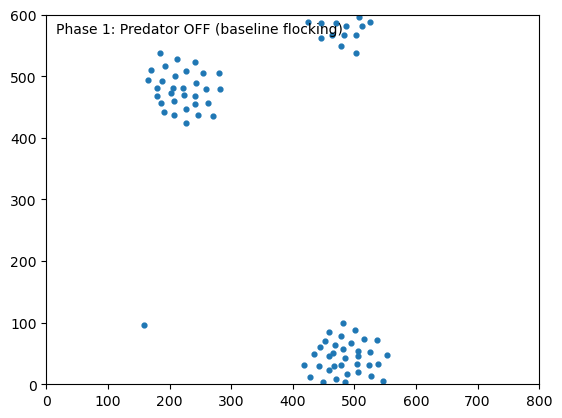

In [25]:
# --- Setup ---
params = {
    "N": 80,
    "width": 800.0,
    "height": 600.0,
    "dt": 0.08,
    "perception_radius": 70.0,
    "sep_radius": 22.0,
    "w_sep": 1.6,
    "w_align": 1.0,
    "w_coh": 1.0,
    "max_speed": 90.0,
    "max_force": 45.0,
    "boundary_mode": "wrap",
    # predator params
    "pred_avoid_radius": 120.0,
    "pred_danger_radius": 80.0,
    "w_pred": 3.0,
}

seed = 42
positions, velocities = init_boids(params["N"], params["width"], params["height"],
                                   speed_range=(30.0, 70.0), seed=seed)

# Predator initial state (will be enabled later)
predator = Predator(position=[params["width"]/2, params["height"]/2],
                    velocity=[0.0, 0.0],
                    max_speed=120.0, max_force=60.0, mode="center")

# Phase schedule
phase1 = 200
phase2 = 200
phase3 = 200
total_frames = phase1 + phase2 + phase3

def predator_active(frame):
    """Predator ON only during Phase 2."""
    return (phase1 <= frame < phase1 + phase2)

# --- Plot ---
fig, ax = plt.subplots()
ax.set_xlim(0, params["width"])
ax.set_ylim(0, params["height"])
ax.set_aspect("equal", adjustable="box")

boid_scat = ax.scatter(positions[:,0], positions[:,1], s=12)
pred_scat = ax.scatter([], [], s=80, marker="x")  # predator marker
title = ax.text(0.02, 0.98, "", transform=ax.transAxes, va="top")

# Optional: circle to show avoidance radius
avoid_circle = plt.Circle((0, 0), params["pred_avoid_radius"], fill=False)
ax.add_patch(avoid_circle)
avoid_circle.set_visible(False)

def update(frame):
    global positions, velocities, predator

    # Determine current phase label
    if frame < phase1:
        phase_label = "Phase 1: Predator OFF (baseline flocking)"
    elif frame < phase1 + phase2:
        phase_label = "Phase 2: Predator ON (disruption)"
    else:
        phase_label = "Phase 3: Predator OFF (recovery)"

    # Predator on/off logic
    if predator_active(frame):
        predator.step(positions, params)
        positions, velocities = step(positions, velocities, params, predator=predator)

        # update predator visuals
        pred_scat.set_offsets(predator.position)
        avoid_circle.center = predator.position
        avoid_circle.set_visible(True)
    else:
        positions, velocities = step(positions, velocities, params, predator=None)
        pred_scat.set_offsets(np.array([[np.nan, np.nan]]))  # hide predator
        avoid_circle.set_visible(False)

    boid_scat.set_offsets(positions)
    title.set_text(phase_label)
    return boid_scat, pred_scat, avoid_circle, title

ani = FuncAnimation(fig, update, frames=total_frames, interval=30, blit=False)
HTML(ani.to_jshtml())
